<a href="https://colab.research.google.com/github/kashyapraval/AIexperiments/blob/master/FFT_on_Audio.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**EXPLORATION ON AUDIO PROCESSING AND COMPRESSION USING FAST FOURIER TRANSFORM(LOSSY)**

In [0]:
import matplotlib.image as mpimg
# import os
# import urllib
import IPython.display as ipd
# import requests
from io import BytesIO
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import wavfile
import librosa

%matplotlib inline
import librosa.display

import tqdm

In [0]:
#afghan = ipd.Audio("https://upload.wikimedia.org/wikipedia/commons/8/8d/Former_Afghan_national_anthem%2C_1992-2006.wav")
#f = urllib.request.urlretrieve("https://upload.wikimedia.org/wikipedia/commons/8/8d/Former_Afghan_national_anthem%2C_1992-2006.wav")


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
y , sr = librosa.load('/content/drive/My Drive/NM_SK.wav')

In [4]:
# ipd.Audio('/content/drive/My Drive/NM_SK.wav') #works but takes up RAM

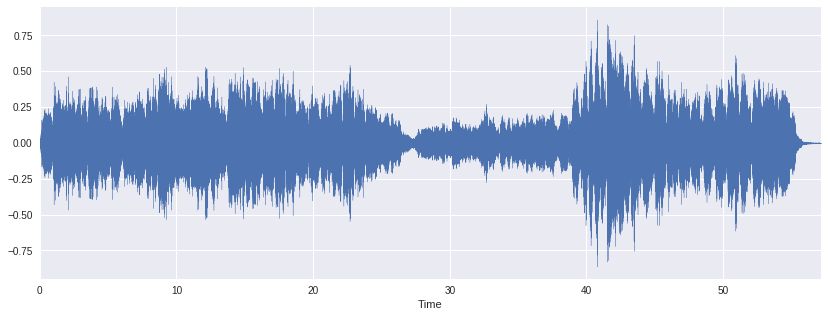

In [4]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(y, sr=sr)

# Superimposition (using sine waves)

Explore how two different sinusoidal waves superimpose and how do they sound.

In [0]:
sr = 22050 # sample rate
T = 1.0    # seconds
t = np.linspace(0, T, int(T*sr), endpoint=False) # time variable
num_samples = sr* T
x1 = np.sin(2*np.pi*40*t)     # sin wave 40 Hz (use headphones. Low frequency so that can be visualised)
x2 = np.sin(2*np.pi*43*t)
x3_ = np.sin((2*np.pi*40*t)+(np.pi)) # shall not work since the results are close to 0(x e-14) but not 0. The player probably normalizes the wave and plays
x3_2 = np.sin((2*np.pi*40*t)+(np.pi))+1*(t==0) #trick to bypass normalisation
x3 = -np.sin(2*np.pi*40*t)
x4 = np.cos(2*np.pi*40*t)
x5 = x1 + x2 # beats
x6 = x1 + x3 # destructive interference i.e. Noise cancellation
x7 = x1 + x4 # constant phase lag
x8 = x1 + x3_  #normalisation shall deter the attempted noise cancellation by phase lag
x9 = x1 + x3_2 #attempted hack around the normalisation problem.

In [0]:
# for x in range(100):
#     t_ = x/100
#     print (t_, ': ', np.sin(2*np.pi*40*t_), "###############", np.sin((2*np.pi*40*t_)+(np.pi))+np.sin(2*np.pi*40*t_))

In [7]:
ipd.Audio(x1, rate=sr)

In [8]:
ipd.Audio(x5, rate=sr) # beats = frequency2 -frequency1 = 43-40 = 3. We hear 4 here because of a beat being split into halves at the ends.

In [9]:
ipd.Audio(x6, rate=sr) # the same as signal: x-x = 0

/usr/local/lib/python3.6/dist-packages/IPython/lib/display.py:135: RuntimeWarning: invalid value encountered in true_divide
  scaled = np.int16(data/np.max(np.abs(data))*32767).tolist()


In [11]:
ipd.Audio(x7, rate=sr) # A constant phase lag of pi/2. Not much difference could be felt on this except at the ends. A usual voice file might imply different.

In [12]:
ipd.Audio(x8, rate=sr) # the signal is close to zero but still non-zero. The player normalises the signal and hence a noise is heard.

In [13]:
ipd.Audio(x9, rate=sr) #attempted hack around the normalisation. This noise cancellation works!

In [0]:
# plt.figure(figsize=(14, 5))
# librosa.display.waveplot(x1, sr=sr)

# Visualizing the Signals

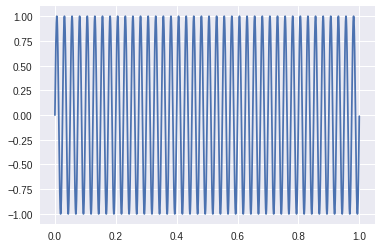

In [14]:
plt.plot(t,x1)
plt.show()

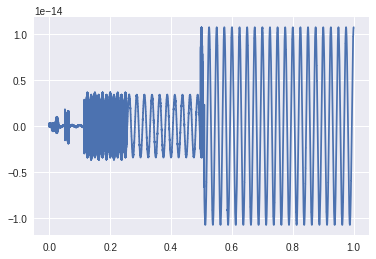

In [15]:
plt.plot(t,x1+x3_)
plt.show()  # note: 1e-14 on the y axis => practically zero but not 0 if scaled back

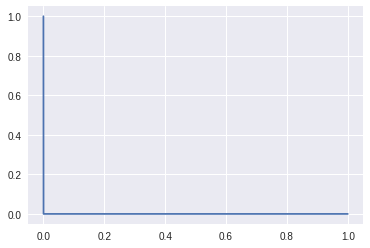

In [16]:
plt.plot(t,x1+x3_2)
plt.show() # note the added spike at t = 0 (which seems like the y axis)

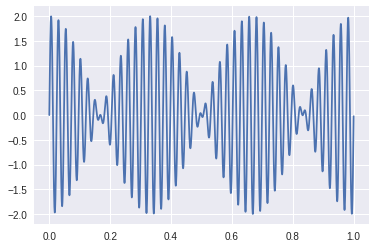

In [17]:
plt.plot(t,x5)
plt.show() # the beats: total of 3 beats.

# Fourier Transform

In [0]:
#num_samples = sr* T # sample rate times duration
fft_output = np.fft.rfft(x5)
magnitude_only = [np.sqrt(i.real**2 + i.imag**2)/len(fft_output) for i in fft_output]
frequencies = [(i*1.0/num_samples)*sr for i in range(int(num_samples//2)+1)]

In [54]:
print (len(magnitude_only), len(frequencies))

11026 11026


In [19]:
magnitude_only[40:45] #peaks at 40th and 43rd index suggesting appropriate transform. Rest all values are close to zero

[0.9999093052784321,
 5.191160871352631e-16,
 1.5383324967934378e-15,
 0.9999093052784331,
 1.10946771540363e-15]

Attempt Compression/approximation of an audio file

In [118]:
y , sr = librosa.load('/content/drive/My Drive/NM_SK.wav')
print (y.shape, sr)

(1260154,) 22050


In [120]:
#trimming to 5 seconds
y_ = y[:sr*5]
y_.shape

(110250,)

In [121]:
num_samples = y_.shape[0]
fft_output = np.fft.rfft(y_)
print(fft_output.shape)
magnitude_only = [np.sqrt(i.real**2 + i.imag**2)/len(fft_output) for i in fft_output]
frequencies = [(i*1.0/num_samples)*sr for i in range(int(num_samples//2)+1)]
print(len(magnitude_only), len(frequencies))

(55126,)
55126 55126


In [122]:
print(np.median(magnitude_only), np.mean(magnitude_only))

2.164504382936297e-05 0.00016821720469459305


/usr/local/lib/python3.6/dist-packages/numpy/core/numeric.py:492: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


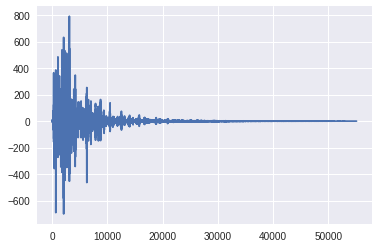

In [123]:
plt.plot(fft_output)

In [124]:
frequencies[np.argmax(magnitude_only)] #corresponds to a D# note

622.8000000000001

In [125]:
frequencies[-1] # is sample_rate/2

11025.0

In [126]:
#What are the major frequencies:
prominent_freq = [frequencies[i] for i in np.argsort(magnitude_only)[-20:]]
prominent_freq

[621.8,
 470.4,
 621.4,
 131.0,
 418.20000000000005,
 623.6,
 414.20000000000005,
 208.8,
 624.0,
 414.0,
 418.4,
 415.0,
 351.4,
 416.2,
 415.8,
 416.00000000000006,
 131.20000000000002,
 416.40000000000003,
 415.59999999999997,
 622.8000000000001]

In [0]:
prominent_mag = np.argsort(magnitude_only)[-1000:] # picking 1k components out of 55k

In [0]:
fft_output2 = fft_output
for i in range(len(fft_output2)):
    if i in prominent_mag:
        continue
    else:
        fft_output2[i] = 0

In [0]:
recreated_y_ = np.fft.irfft(fft_output2)

In [130]:
ipd.Audio(recreated_y_, rate=sr) # Note the percussion instruments have been wiped out

In [131]:
ipd.Audio(y_, rate=sr)

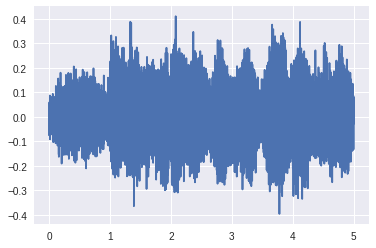

In [132]:
plt.plot(t, recreated_y_)

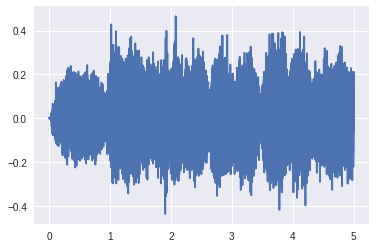

In [133]:
plt.plot(t, y_)